In [41]:
using CSV
using DataFrames
using Random
using Glob
using GLM
using Gadfly
import Cairo, Fontconfig
ENV["COLUMNS"] = 1000;

┌ Info: Precompiling GLM [38e38edf-8417-5370-95a0-9cbb8c7f171a]
└ @ Base loading.jl:1278


In [7]:
fns = glob("*.csv", "../../../../results/2020-11-01/experiment43/")
dfs = [DataFrame(CSV.File(fn)) for fn in fns]
results_exp43 = vcat(dfs...);

In [10]:
sort!(results_exp43, :N);

In [11]:
@show nrow(results_exp43)
first(results_exp43, 3)

nrow(results_exp43) = 3060


,N,n,m,p,ρe,ρh,ρt,match_ratio,alignment_strength_1,alignment_strength_2,iter,maxiter,sgm_time,distribution,experiment
,Int64,Int64,Int64,Float64,Float64,Int64,Float64,Float64,Float64,Float64,Int64,Int64,Float64,String,String
1,503,503,0,0.05,0.0,0,0.0,0.00397614,0.225981,0.225981,20,20,2.17467,erdosrenyi,43a
2,503,503,0,0.1,0.0,0,0.0,0.0,0.194612,0.194612,20,20,2.18644,erdosrenyi,43a
3,503,503,0,0.2,0.0,0,0.0,0.00397614,0.174773,0.174773,20,20,3.1738,erdosrenyi,43a


In [36]:
defaultfont = "CMU Serif";
fontstyles = (
    key_title_font = defaultfont,
    key_label_font = defaultfont,
    minor_label_font = defaultfont,
    major_label_font = defaultfont,
    key_title_font_size = 14px,
    key_label_font_size = 12px,
    minor_label_font_size = 14px,
    major_label_font_size = 16px,
);

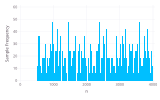

In [101]:
plot(
    results_exp43,
    x = :n,
    Geom.histogram,
    Guide.xlabel("n"),
    Guide.ylabel("Sample Frequency"),
    Scale.x_continuous(format=:plain),
    style(;fontstyles...),
) |> SVG(16cm, 10cm)

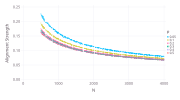

In [106]:
exp43_fig1 = plot(
    results_exp43,
    x = :N, y = :alignment_strength_1, color = :p,
    Geom.point,
    Scale.color_discrete,
    Guide.ylabel("Alignment Strength"),
    Scale.x_continuous(format=:plain),
    style(
        highlight_width=0px,
        point_size=0.4mm,
        ;fontstyles...,
    ),
)
exp43_fig1 |> SVG(18cm, 10cm)
exp43_fig1 |> PDF("exp43_fig1.pdf", 18cm, 10cm)

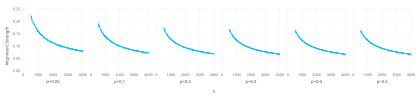

In [107]:
exp43_fig2 = plot(
    results_exp43,
    x = :n, y = :alignment_strength_1, xgroup = :p,
    Geom.subplot_grid(Geom.point),
    Scale.x_continuous(format=:plain),
    Scale.xgroup(labels=p -> "p=$(p)"),
    Guide.ylabel("Alignment Strength"),
    Guide.xlabel("n"),
    style(
        highlight_width=0px,
        # highlight_width=0.2px,
        point_size=0.4mm,
        ;fontstyles...,
    ),
)
exp43_fig2 |> SVG(42cm, 10cm)
exp43_fig2 |> PDF("exp43_fig2.pdf", 42cm, 10cm)

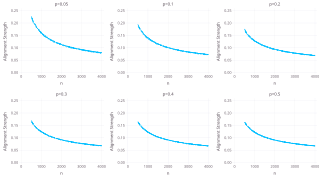

In [147]:
plts = Plot[]
for p in pvals
    results_exp43_p = filter(row -> row.p == p, results_exp43)
    p = plot(
        layer(
            results_exp43_p,
            x = :n, y = :alignment_strength_1,
            Geom.point,
        ),
        Scale.x_continuous(format=:plain),
        Guide.ylabel("Alignment Strength"),
        Guide.xlabel("n"),
        Guide.title("p=$(p)"),
        Coord.cartesian(ymin=0, ymax=0.25, xmin=0, xmax=4000),
        style(
            highlight_width=0px,
            # highlight_width=0.2px,
            point_size=0.4mm,
            plot_padding=[3mm],
            ;fontstyles...,
        ),
    )
    push!(plts, p)
end
exp43_fig2_stacked = gridstack(permutedims(reshape(plts, (3,2)), (2,1)))
exp43_fig2_stacked |> SVG(32cm, 18cm)
exp43_fig2_stacked |> PDF("exp43_fig2_stacked.pdf", 32cm, 18cm)

In [67]:
n_tfm(n) = sqrt(log(n) / n)
results_exp43.sqrt_logn_over_n = map(n_tfm, results_exp43.n);

In [68]:
pvals = sort(unique(results_exp43.p));

In [87]:
regressions = Dict{Float64,Any}()
for p in pvals
    results_exp43_p = filter(row -> row.p == p, results_exp43)
    reg = lm(@formula(alignment_strength_1 ~ sqrt_logn_over_n), results_exp43_p)
    regressions[p] = reg
end

In [148]:
for p in pvals
    reg = regressions[p]
    @show p, r2(reg), stderror(reg)
end

(p, r2(reg), stderror(reg)) = (0.05, 0.9984970924335081, [0.0002508839845373893, 0.003766943563482927])
(p, r2(reg), stderror(reg)) = (0.1, 0.9988136684272473, [0.00018305245999523584, 0.002748474707264569])
(p, r2(reg), stderror(reg)) = (0.2, 0.9991302702270547, [0.000137480954333935, 0.002064232983961264])
(p, r2(reg), stderror(reg)) = (0.3, 0.999236962456118, [0.00012366079689106734, 0.0018567276973176182])
(p, r2(reg), stderror(reg)) = (0.4, 0.9993673186345471, [0.0001099964182260741, 0.0016515613796827884])
(p, r2(reg), stderror(reg)) = (0.5, 0.9994234940995099, [0.00010407188575317666, 0.001562606401123363])


In [149]:
regression_info = DataFrame(p=Float64[], r2=Float64[], d=Float64[], c=Float64[], d_err=Float64[], c_err=Float64[])
for p in pvals
    reg = regressions[p]
    d,c = coef(reg)
    d_err,c_err = stderror(reg)
    push!(regression_info, (r2=r2(reg),p=p,d=d,c=c,d_err=d_err,c_err=c_err))
end
regression_info

,p,r2,d,c,d_err,c_err
,Float64,Float64,Float64,Float64,Float64,Float64
1,0.05,0.998497,-0.0211519,2.18841,0.000250884,0.00376694
2,0.1,0.998814,-0.00991992,1.79747,0.000183052,0.00274847
3,0.2,0.99913,-0.00314745,1.57692,0.000137481,0.00206423
4,0.3,0.999237,-0.00145523,1.5144,0.000123661,0.00185673
5,0.4,0.999367,-0.000124146,1.47944,0.000109996,0.00165156
6,0.5,0.999423,0.000431164,1.46641,0.000104072,0.00156261


In [98]:
regression_coefs = DataFrame(p=Float64[], d=Float64[], c=Float64[])
for p in pvals
    reg = regressions[p]
    d,c = coef(reg)
    push!(regression_coefs, (p=p,d=d,c=c))
end
regression_coefs

,p,d,c
,Float64,Float64,Float64
1,0.05,-0.0211519,2.18841
2,0.1,-0.00991992,1.79747
3,0.2,-0.00314745,1.57692
4,0.3,-0.00145523,1.5144
5,0.4,-0.000124146,1.47944
6,0.5,0.000431164,1.46641


In [88]:
fit_preds = DataFrame(p=Float64[], n=Int[], sqrt_logn_over_n=Float64[], alignment_strength_1=Float64[])
for p in pvals
    reg = regressions[p]
    
    ns = collect(500:2:4000)
    df = DataFrame(
        p = fill(p, length(ns)),
        n = ns,
        sqrt_logn_over_n = map(n_tfm, ns),
    )
    
    preds = predict(reg, df)
    df.alignment_strength_1 = preds
    
    fit_preds = vcat(fit_preds, df)
end

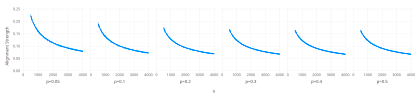

In [108]:
exp43_fig3 = plot(
    results_exp43, xgroup = :p,
    Geom.subplot_grid(
        layer(
            x = :n, y = :alignment_strength_1,
            Geom.point,
        ),
        layer(
            fit_preds,
            x = :n, y = :alignment_strength_1, xgroup = :p,
            Geom.line,
            style(default_color=colorant"blue"),
            order=10,
        ),
    ),
    Scale.x_continuous(format=:plain),
    Scale.xgroup(labels=p -> "p=$(p)"),
    Guide.ylabel("Alignment Strength"),
    Guide.xlabel("n"),
    style(
        highlight_width=0px,
        # highlight_width=0.2px,
        point_size=0.4mm,
        ;fontstyles...,
    ),
)
exp43_fig3 |> SVG(42cm, 10cm)
exp43_fig3 |> PDF("exp43_fig3.pdf", 42cm, 10cm)

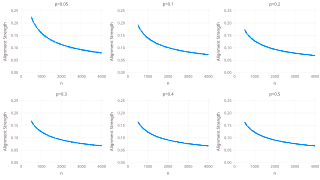

In [145]:
plts = Plot[]
for p in pvals
    results_exp43_p = filter(row -> row.p == p, results_exp43)
    fit_preds_p = filter(row -> row.p == p, fit_preds)
    p = plot(
        layer(
            results_exp43_p,
            x = :n, y = :alignment_strength_1,
            Geom.point,
        ),
        layer(
            fit_preds_p,
            x = :n, y = :alignment_strength_1,
            Geom.line,
            style(default_color=colorant"blue"),
            order=10,
        ),
        Scale.x_continuous(format=:plain),
        Guide.ylabel("Alignment Strength"),
        Guide.xlabel("n"),
        Guide.title("p=$(p)"),
        Coord.cartesian(ymin=0, ymax=0.25, xmin=0, xmax=4000),
        style(
            highlight_width=0px,
            # highlight_width=0.2px,
            point_size=0.4mm,
            plot_padding=[3mm],
            ;fontstyles...,
        ),
    )
    push!(plts, p)
end
exp43_fig3_stacked = gridstack(permutedims(reshape(plts, (3,2)), (2,1)))
exp43_fig3_stacked |> SVG(32cm, 18cm)
exp43_fig3_stacked |> PDF("exp43_fig3_stacked.pdf", 32cm, 18cm)

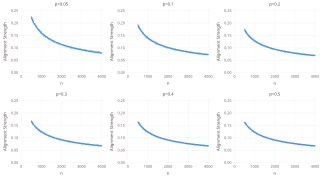

In [169]:
plts = Plot[]
for p in pvals
    results_exp43_p = filter(row -> row.p == p, results_exp43)
    fit_preds_p = filter(row -> row.p == p, fit_preds)
    p = plot(
        layer(
            results_exp43_p,
            x = :n, y = :alignment_strength_1,
            Geom.point,
            style(
                highlight_width=0px,
#                 highlight_width=0.3px,
                point_size=0.7mm,
                default_color=colorant"lightskyblue",
            ),
        ),
        layer(
            fit_preds_p,
            x = :n, y = :alignment_strength_1,
            Geom.line,
#             style(default_color=colorant"blue"),
            style(default_color=colorant"darkblue"),
            order=10,
        ),
        Scale.x_continuous(format=:plain),
        Guide.ylabel("Alignment Strength"),
        Guide.xlabel("n"),
        Guide.title("p=$(p)"),
        Coord.cartesian(ymin=0, ymax=0.25, xmin=0, xmax=4000),
        style(
#             highlight_width=0px,
#             highlight_width=0.3px,
#             point_size=0.7mm,
            line_width=0.08mm,
            plot_padding=[3mm],
            ;fontstyles...,
        ),
    )
    push!(plts, p)
end
exp43_fig3_stacked = gridstack(permutedims(reshape(plts, (3,2)), (2,1)))
exp43_fig3_stacked |> SVG(32cm, 18cm)
# exp43_fig3_stacked |> SVG(48cm, 27cm)
exp43_fig3_stacked |> PDF("exp43_fig3_stacked_test1.pdf", 32cm, 18cm)

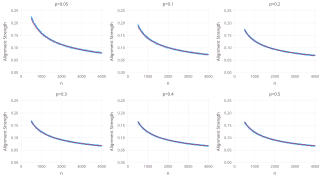

In [168]:
plts = Plot[]
for p in pvals
    results_exp43_p = filter(row -> row.p == p, results_exp43)
    fit_preds_p = filter(row -> row.p == p, fit_preds)
    fit_preds_largen_p = filter(row -> row.p == p, fit_preds_largen)
    p = plot(
        layer(
            results_exp43_p,
            x = :n, y = :alignment_strength_1,
            Geom.point,
            style(
                highlight_width=0px,
#                 highlight_width=0.3px,
                point_size=0.7mm,
                default_color=colorant"lightskyblue",
            ),
        ),
        layer(
            fit_preds_p,
            x = :n, y = :alignment_strength_1,
            Geom.line,
#             style(default_color=colorant"blue"),
            style(default_color=colorant"darkblue"),
            order=10,
        ),
        layer(
            fit_preds_largen_p,
            x = :n, y = :alignment_strength_1,
            Geom.line,
            style(default_color=colorant"red"),
            order=12,
        ),
        Scale.x_continuous(format=:plain),
        Guide.ylabel("Alignment Strength"),
        Guide.xlabel("n"),
        Guide.title("p=$(p)"),
        Coord.cartesian(ymin=0, ymax=0.25, xmin=0, xmax=4000),
        style(
#             highlight_width=0px,
#             highlight_width=0.3px,
#             point_size=0.7mm,
            line_width=0.08mm,
            plot_padding=[3mm],
            ;fontstyles...,
        ),
    )
    push!(plts, p)
end
exp43_fig3_stacked = gridstack(permutedims(reshape(plts, (3,2)), (2,1)))
exp43_fig3_stacked |> SVG(32cm, 18cm)
exp43_fig3_stacked |> PDF("exp43_fig3_stacked_test2.pdf", 32cm, 18cm)

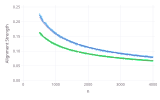

In [181]:
layers = []
point_colors = [colorant"lightskyblue", colorant"seagreen1"]
line_colors_1 = [colorant"navyblue", colorant"darkgreen"]
line_colors_2 = [colorant"purple4", colorant"red"]
for (i,p) in enumerate(pvals[[1,end]])
    results_exp43_p = filter(row -> row.p == p, results_exp43)
    fit_preds_p = filter(row -> row.p == p, fit_preds)
    fit_preds_largen_p = filter(row -> row.p == p, fit_preds_largen)
    l1 = layer(
        results_exp43_p,
        x = :n, y = :alignment_strength_1,
        Geom.point,
        style(
            highlight_width=0px,
            point_size=0.7mm,
            default_color=point_colors[i],
        ),
        order=1,
    )
    l2 = layer(
        fit_preds_p,
        x = :n, y = :alignment_strength_1,
        Geom.line,
        style(default_color=line_colors_1[i], line_width=0.2mm,),
        order=15,
    )
    l3 = layer(
        fit_preds_largen_p,
        x = :n, y = :alignment_strength_1,
        Geom.line,
        style(default_color=line_colors_2[i], line_width=0.2mm),
        order=12,
    )
    push!(layers, l1)
    push!(layers, l2)
    push!(layers, l3)
end
plt = plot(
    layers...,
    Scale.x_continuous(format=:plain),
    Guide.ylabel("Alignment Strength"),
    Guide.xlabel("n"),
    Coord.cartesian(ymin=0, ymax=0.25, xmin=0, xmax=4000),
    style(
        ;fontstyles...,
    ),
)
plt |> SVG(16cm, 10cm)
plt |> PDF("exp43_fig5.pdf", 16cm, 10cm)

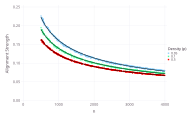

In [196]:
layers = []
point_colors = [colorant"lightskyblue", colorant"seagreen1", colorant"red"]
line_colors_1 = [colorant"navyblue", colorant"darkgreen", colorant"red4"]
line_colors_2 = [colorant"purple4", colorant"red", colorant"pink"]
for (i,p) in enumerate(pvals[[1,2,6]])
    results_exp43_p = filter(row -> row.p == p, results_exp43)
    fit_preds_p = filter(row -> row.p == p, fit_preds)
    fit_preds_largen_p = filter(row -> row.p == p, fit_preds_largen)
    l1 = layer(
        results_exp43_p,
        x = :n, y = :alignment_strength_1,
        Geom.point,
        style(
            highlight_width=0px,
            point_size=0.7mm,
            default_color=point_colors[i],
        ),
        order=1,
    )
    l2 = layer(
        fit_preds_p,
        x = :n, y = :alignment_strength_1,
        Geom.line,
#         style(default_color=line_colors_1[i], line_width=0.5mm,),
        style(default_color=colorant"black", line_width=0.5mm,),
        order=15,
    )
#     l3 = layer(
#         fit_preds_largen_p,
#         x = :n, y = :alignment_strength_1,
#         Geom.line,
#         style(default_color=line_colors_2[i], line_width=0.2mm),
#         order=12,
#     )
    push!(layers, l1)
    push!(layers, l2)
#     push!(layers, l3)
end
plt = plot(
    layers...,
    Scale.x_continuous(format=:plain),
    Guide.ylabel("Alignment Strength"),
    Guide.xlabel("n"),
    Coord.cartesian(ymin=0, ymax=0.25, xmin=0, xmax=4000),
    Guide.manual_color_key("Density (p)", string.(pvals[[1,2,6]]), point_colors),
    style(
        ;fontstyles...,
    ),
)
plt |> SVG(19cm, 12cm)
plt |> PDF("exp43_fig6.pdf", 19cm, 12cm)

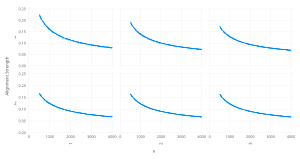

In [121]:
results_exp43_alt = deepcopy(results_exp43)
fit_preds_alt = deepcopy(fit_preds)
col_dict = Dict(0.05 => 1, 0.1 => 2, 0.2 => 3, 0.3 => 1, 0.4 => 2, 0.5 => 3)
results_exp43_alt.row = map(p -> p in [0.05, 0.1, 0.2] ? 1 : 2, results_exp43_alt.p)
results_exp43_alt.col = map(p -> col_dict[p], results_exp43_alt.p)
fit_preds_alt.row = map(p -> p in [0.05, 0.1, 0.2] ? 1 : 2, fit_preds_alt.p)
fit_preds_alt.col = map(p -> col_dict[p], fit_preds_alt.p)
plot(
    results_exp43_alt, xgroup = :col, ygroup = :row,
    Geom.subplot_grid(
        layer(
            x = :n, y = :alignment_strength_1,
            Geom.point,
        ),
        layer(
            fit_preds_alt,
            x = :n, y = :alignment_strength_1, xgroup = :col, ygroup = :row,
            Geom.line,
            style(default_color=colorant"blue"),
            order=10,
        ),
    ),
    Scale.x_continuous(format=:plain),
    Guide.ylabel("Alignment Strength"),
    Guide.xlabel("n"),
    style(
        highlight_width=0px,
        point_size=0.4mm,
        ;fontstyles...,
    ),
) |> SVG(30cm, 16cm)

,p,d,c
,Float64,Float64,Float64
1,0.05,-0.014533,2.06623
2,0.1,-0.00598211,1.7239
3,0.2,-0.00223142,1.55962
4,0.3,-2.24101e-5,1.48619
5,0.4,-0.000546201,1.48709
6,0.5,-0.000404651,1.4821


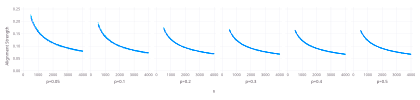

In [109]:
regressions_largen = Dict{Float64,Any}()
for p in pvals
    results_exp43_p = filter(row -> (row.p == p) && (2500 <= row.n <= 4000), results_exp43)
    reg = lm(@formula(alignment_strength_1 ~ sqrt_logn_over_n), results_exp43_p)
    regressions_largen[p] = reg
end

regression_coefs_largen = DataFrame(p=Float64[], d=Float64[], c=Float64[])
for p in pvals
    reg = regressions_largen[p]
    d,c = coef(reg)
    push!(regression_coefs_largen, (p=p,d=d,c=c))
end
display(regression_coefs_largen)

fit_preds_largen = DataFrame(p=Float64[], n=Int[], sqrt_logn_over_n=Float64[], alignment_strength_1=Float64[])
for p in pvals
    reg = regressions_largen[p]
    
    ns = collect(500:2:4000)
    df = DataFrame(
        p = fill(p, length(ns)),
        n = ns,
        sqrt_logn_over_n = map(n_tfm, ns),
    )
    
    preds = predict(reg, df)
    df.alignment_strength_1 = preds
    
    fit_preds_largen = vcat(fit_preds_largen, df)
end

exp43_fig4 = plot(
    results_exp43, xgroup = :p,
    Geom.subplot_grid(
        layer(
            x = :n, y = :alignment_strength_1,
            Geom.point,
        ),
        layer(
            fit_preds_largen,
            x = :n, y = :alignment_strength_1, xgroup = :p,
            Geom.line,
            style(default_color=colorant"blue"),
            order=10,
        ),
    ),
    Scale.x_continuous(format=:plain),
    Scale.xgroup(labels=p -> "p=$(p)"),
    Guide.ylabel("Alignment Strength"),
    Guide.xlabel("n"),
    style(
        highlight_width=0px,
        # highlight_width=0.2px,
        point_size=0.4mm,
        ;fontstyles...,
    ),
)
exp43_fig4 |> SVG(42cm, 10cm)
exp43_fig4 |> PDF("exp43_fig4.pdf", 42cm, 10cm)

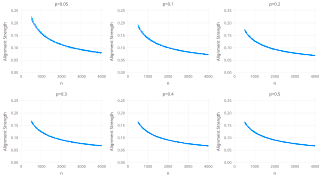

In [146]:
plts = Plot[]
for p in pvals
    results_exp43_p = filter(row -> row.p == p, results_exp43)
    fit_preds_largen_p = filter(row -> row.p == p, fit_preds_largen)
    p = plot(
        layer(
            results_exp43_p,
            x = :n, y = :alignment_strength_1,
            Geom.point,
        ),
        layer(
            fit_preds_largen_p,
            x = :n, y = :alignment_strength_1,
            Geom.line,
            style(default_color=colorant"blue"),
            order=10,
        ),
        Scale.x_continuous(format=:plain),
        Guide.ylabel("Alignment Strength"),
        Guide.xlabel("n"),
        Guide.title("p=$(p)"),
        Coord.cartesian(ymin=0, ymax=0.25, xmin=0, xmax=4000),
        style(
            highlight_width=0px,
            # highlight_width=0.2px,
            point_size=0.4mm,
            plot_padding=[3mm],
            ;fontstyles...,
        ),
    )
    push!(plts, p)
end
exp43_fig4_stacked = gridstack(permutedims(reshape(plts, (3,2)), (2,1)))
exp43_fig4_stacked |> SVG(32cm, 18cm)
exp43_fig4_stacked |> PDF("exp43_fig4_stacked.pdf", 32cm, 18cm)

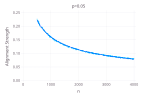

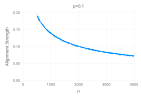

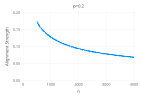

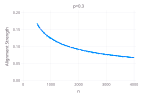

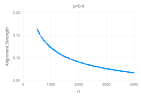

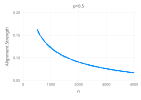

In [82]:
for p in pvals
    results_exp43_p = filter(row -> row.p == p, results_exp43)
    fit_preds_p = filter(row -> row.p == p, fit_preds)
    plot(
        layer(
            results_exp43_p,
            x=:n, y=:alignment_strength_1,
            Geom.point,
        ),
        layer(
            fit_preds_p,
            x=:n, y=:alignment_strength_1,
            Geom.line,
            style(default_color=colorant"blue"),
            order=10,
        ),
        Guide.title("p=$(p)"),
        Guide.ylabel("Alignment Strength"),
        Guide.xlabel("n"),
        Scale.x_continuous(format=:plain),
        style(
            highlight_width=0px,
            point_size=0.4mm,
            ;fontstyles...,
        ),
    ) |> SVG()
end